In [22]:
import dynamiqs as dq
import jax.numpy as jnp
import numpy as np

Define units:

In [23]:
GHz = 1.0
MHz = 1e-3 * GHz
kHz = 1e-3 * MHz

Define system parameters:

In [24]:
omega_a_0 = 5.26 * GHz # bare resonant frequency of mode a
omega_b_0 = 7.7 * GHz # bare resonant frequency of mode b

phi_a = 0.06 # zero-point fluctuation phase of mode a
phi_b = 0.29 # zero-point fluctuation phase of mode a
e_J = 12.03 * GHz # Josephson energy
delta_e_J = 0.47 * GHz

kappa_a = 9.3 * kHz # relaxation rate of mode a
kappa_b = 2.6 * MHz # relaxation rate of mode b

g2_target = 0.763*MHz # target g2 used to specify driving strength of ATS
alpha_target = np.sqrt(5.0) # target alpha, (or equivalently specify number of photons)

#driving strengths:
epsilon_p = 2*g2_target/(e_J * phi_a**2 * phi_b) # flux pump power
epsilon_d = -alpha_target**2 * np.conj(g2_target) # buffer pump power

In [25]:
epsilon_p

0.12150339349582621

In [26]:
epsilon_d

-0.0038150000000000007

### Compute AC Stark shift

In [27]:
#initialization:
delta_a, delta_b = (0.0,0.0) # set initial AC Stark shifts to zero
omega_p = 2*omega_a_0 - omega_b_0 # initial frequency matching condition

#recursion loop to compute AC Stark shift:
rec_depth = 30
for i in range(rec_depth):
    #compute xi for mode a and b:
    alpha_1 = 1j*e_J*epsilon_p*phi_a / (kappa_a/2 + 1j*(omega_a_0 - omega_p))
    alpha_2 = 1j*e_J*epsilon_p*phi_a / (kappa_a/2 + 1j*(omega_a_0 + omega_p))

    beta_1 = 1j*e_J*epsilon_p*phi_b / (kappa_b/2 + 1j*(omega_b_0 - omega_p))
    beta_2 = 1j*e_J*epsilon_p*phi_b / (kappa_b/2 + 1j*(omega_b_0 + omega_p))

    pre = (np.real(alpha_1) + np.real(alpha_2)) * phi_a \
    + (np.real(beta_1) + np.real(beta_2)) * phi_b
    #compute AC Stark shifts:
    delta_a = 1/3*e_J * epsilon_p * phi_a**2 * pre 
    delta_b = 1/3*e_J * epsilon_p * phi_b**2 * pre 

    #recompute frequencies
    omega_a = omega_a_0 - 2*delta_e_J*phi_a**2 + delta_a 
    omega_b = omega_b_0 - 2*delta_e_J*phi_b**2 + delta_b 
    omega_p = 2*omega_a - omega_b

omega_d = omega_b

In [28]:
print("Updated omega_a =", omega_a)
print("Updated omega_b =", omega_b)
print("Updated omega_p =", omega_p)
print("Buffer drive frequency omega_d =", omega_d)


Updated omega_a = 5.2566862215107335
Updated omega_b = 7.622586452514629
Updated omega_p = 2.8907859905068376
Buffer drive frequency omega_d = 7.622586452514629


### Construct Hilbert space operators

In [29]:
#Fock-space dimension in the memory mode:
n_fock_a = 30
#Fock-space dimension in the buffer mode:
n_fock_b = 7

#annihilation operators:
a, b = dq.destroy(n_fock_a, n_fock_b)

#identity operator:
identity = dq.tensor(dq.eye(n_fock_a), dq.eye(n_fock_b))

Define ATS driving term

In [30]:
# define the ATS driving term
eps_ats = lambda t: epsilon_p*jnp.cos(omega_p*t)

Define time-dependent displaced-rotated operator:

In [31]:
def op_rot_displaced(t, op, omega_rot, dis):
    return op*jnp.exp(-1j*omega_rot*t) + dis * identity

### Define time-dependent Hamiltonian in the displaced-rotated frame
The Hamiltonian consists of 5 parts:

`h_0`: bare non-interacting Hamiltonian

`h_ATS`: Hamiltonian of the ATS

`h_buffer_drive`: Hamiltonian of the buffer drive

`h_rot`: Term from derivative of rotating frame

`h_dis`: Term from derivative of displaced frame

In [32]:
# For the rotating frame, we choose:
omega_rot_a = omega_a_0  # for mode a, we rotate at its bare frequency (or updated frequency)
omega_rot_b = omega_d    # for mode b (buffer), choose the drive frequency (omega_d)
def hamiltonian_rotating_displaced(t):

    #compute displacement fields
    alpha_t = alpha_1*jnp.exp(-1j*omega_p*t) + alpha_2*jnp.exp(1j*omega_p*t)
    beta_t = beta_1*jnp.exp(-1j*omega_p*t) + beta_2*jnp.exp(1j*omega_p*t)


    # the displaced rotating frame introduces a drive and detuning
    d_alpha_t = 1j*omega_p * (alpha_2*jnp.exp(1j*omega_p*t) - alpha_1*jnp.exp(-1j*omega_p*t))
    d_beta_t = 1j*omega_p * (beta_2*jnp.exp(1j*omega_p*t) - beta_1*jnp.exp(-1j*omega_p*t))


    #compute rotated displaced operators:
    # These are obtained by applying our op_rot_displaced function.
    a_f    = op_rot_displaced(t, a,    omega_rot_a, alpha_t)
    adag_f = op_rot_displaced(t, a.dag(), omega_rot_a, jnp.conj(alpha_t))
    b_f    = op_rot_displaced(t, b,    omega_rot_b, beta_t)
    bdag_f = op_rot_displaced(t, b.dag(), omega_rot_b, jnp.conj(beta_t))

    #displaced rotated phase operator
    phi_f = phi_a*(a_f + adag_f) + phi_b*(b_f + bdag_f)

    #linear term
    h_0 = omega_a_0 * adag_f @ a_f + omega_b_0 * bdag_f @ b_f
    
    #term from derivative of rotating frame
    h_rot = - omega_rot_a * dq.dag(a) @ a  - omega_rot_b * dq.dag(b) @ b
    
    #term from derivative of displaced frame
    h_dis =  -1j*(d_alpha_t*dq.dag(a)*jnp.exp(1j*omega_rot_a*t)-jnp.conj(d_alpha_t)*a*jnp.exp(-1j*omega_rot_a*t)) \
      - 1j*(d_beta_t*dq.dag(b)*jnp.exp(1j*omega_rot_b*t)-jnp.conj(d_beta_t)*b*jnp.exp(-1j*omega_rot_b*t))
        

    #ats term:
    sinterm = jnp.sin(eps_ats(t)) * dq.sinm(phi_f)
    costerm = jnp.cos(eps_ats(t)) * dq.cosm(phi_f)
    h_ats = - 2*e_J*sinterm +  2*delta_e_J*costerm 
    
    #drive on the buffer:
    # in the rotating frame, this term is non-rotating
    h_buffer_drive = jnp.conj(epsilon_d)*jnp.exp(1j*omega_d*t)*b_f \
        + epsilon_d * jnp.exp(-1j*omega_d*t) * bdag_f
    
    return h_0 + h_ats + h_buffer_drive + h_rot + h_dis

In [33]:
# Make Hamiltonian time-callable JAX function:
H = dq.timecallable(hamiltonian_rotating_displaced)

/opt/anaconda3/lib/python3.12/site-packages/equinox/_module.py:1096: UserWarning: A `SparseDIAQArray` has been converted to a `DenseQArray` while computing its matrix exponential.
  return self.__func__(self.__self__, *args, **kwargs)
/var/folders/dt/2zp19ypj0t7c4mhf0083mz840000gn/T/ipykernel_14863/3274938278.py:47: UserWarning: A sparse qarray has been converted to dense layout due to element-wise addition with a dense qarray.
  return h_0 + h_ats + h_buffer_drive + h_rot + h_dis
/opt/anaconda3/lib/python3.12/site-packages/dynamiqs/qarrays/qarray.py:481: UserWarning: A sparse qarray has been converted to dense layout due to element-wise addition with a dense qarray.
  return self.__add__(y)


In [34]:
# For a direct lab–frame simulation one would use the original Hamiltonian.
# (For brevity, here we assume that one has defined H_lab similarly, e.g., without the
# displacement/rotation. In many cases you would simply simulate H vs. time.)
#
# As an example, let’s simulate the lab–frame dynamics (here we reuse H as a placeholder).

# Define the collapse operators (loss in both modes)

In [35]:
c_ops = [jnp.sqrt(kappa_a) * a, jnp.sqrt(kappa_b) * b]


In [36]:
# Starting from the vacuum in both modes:
psi0 = dq.tensor(dq.coherent(n_fock_a, 0.0), dq.coherent(n_fock_b, 0.0))

In [37]:
# Define a time grid (here T is the total simulation time – adjust as needed)
T = 50.0  # simulation time (in units consistent with our frequencies)
tsave = jnp.linspace(0, T, 400)

In [38]:
def hamiltonian_lab(t):
    # Define the phase operator: φ = φ_a*(a + a†) + φ_b*(b + b†)
    phi_op = phi_a * (a + a.dag()) + phi_b * (b + b.dag())
    
    # Bare Hamiltonian: H0 = ω_a0 a†a + ω_b0 b†b
    H0 = omega_a_0 * a.dag() @ a + omega_b_0 * b.dag() @ b
    
    # Time-dependent flux pump: ε(t) = ε_p cos(ω_p t)
    eps_t = epsilon_p * jnp.cos(omega_p * t)
    
    # ATS Hamiltonian: includes sin and cos functions of the phase operator
    H_ATS = -2 * e_J * jnp.sin(eps_t) * dq.sinm(phi_op) + 2 * delta_e_J * jnp.cos(eps_t) * dq.cosm(phi_op)
    
    # Buffer drive term: H_d = 2 ε_d cos(ω_d t)(b + b†)
    H_d = 2 * epsilon_d * jnp.cos(omega_d * t) * (b + b.dag())
    
    return H0 + H_ATS + H_d

# Make H_lab a time-callable JAX function.
H_lab = dq.timecallable(hamiltonian_lab)

/var/folders/dt/2zp19ypj0t7c4mhf0083mz840000gn/T/ipykernel_14863/1151585860.py:17: UserWarning: A sparse qarray has been converted to dense layout due to element-wise addition with a dense qarray.
  return H0 + H_ATS + H_d


In [40]:
# Choose rotation frequencies: for mode a we use its bare frequency, and for mode b we use ω_d.
omega_rot_a = omega_a_0
omega_rot_b = omega_d


def hamiltonian_rotating_displaced(t):
    # --- Compute displacement fields ---
    alpha_t = alpha_1 * jnp.exp(-1j * omega_p * t) + alpha_2 * jnp.exp(1j * omega_p * t)
    beta_t  = beta_1  * jnp.exp(-1j * omega_p * t) + beta_2  * jnp.exp(1j * omega_p * t)
    
    # Time derivatives of the displacement fields.
    d_alpha_t = 1j * omega_p * (alpha_2 * jnp.exp(1j * omega_p * t) - alpha_1 * jnp.exp(-1j * omega_p * t))
    d_beta_t  = 1j * omega_p * (beta_2  * jnp.exp(1j * omega_p * t) - beta_1  * jnp.exp(-1j * omega_p * t))
    
    # --- Rotated–Displaced Operators ---
    a_f    = op_rot_displaced(t, a,    omega_rot_a, alpha_t)
    adag_f = op_rot_displaced(t, a.dag(), omega_rot_a, jnp.conj(alpha_t))
    b_f    = op_rot_displaced(t, b,    omega_rot_b, beta_t)
    bdag_f = op_rot_displaced(t, b.dag(), omega_rot_b, jnp.conj(beta_t))
    
    # Phase operator in the rotated–displaced frame:
    phi_f = phi_a * (a_f + adag_f) + phi_b * (b_f + bdag_f)
    
    # --- Other Hamiltonian Contributions ---
    h0 = omega_a_0 * adag_f @ a_f + omega_b_0 * bdag_f @ b_f
    
    # Correction term from the rotating frame derivative:
    h_rot = - omega_rot_a * (a.dag() @ a) - omega_rot_b * (b.dag() @ b)
    
    # Correction term from the time dependence of the displacement:
    h_dis = (-1j * (d_alpha_t * a.dag() * jnp.exp(1j * omega_rot_a * t)
                     - jnp.conj(d_alpha_t) * a * jnp.exp(-1j * omega_rot_a * t))
             -1j * (d_beta_t  * b.dag() * jnp.exp(1j * omega_rot_b * t)
                     - jnp.conj(d_beta_t) * b * jnp.exp(-1j * omega_rot_b * t)))
    
    # --- ATS Term using Taylor Expansion ---
    # For the sine part:
    # sin(ε(t)) ~ ε(t)   and   sin(φ_f) ~ φ_f - φ_f^3/6,
    # so -2E_J sin(ε(t)) sin(φ_f) ≈ -2E_J ε(t) φ_f + (1/3)E_J ε(t) φ_f^3.
    phi_f_cube = phi_f @ phi_f @ phi_f
    taylor_sine_term = -2 * e_J * eps_ats(t) * phi_f + (1/3) * e_J * eps_ats(t) * phi_f_cube
    
    # For the cosine part:
    # cos(ε(t)) ~ 1 - ε(t)^2/2   and   cos(φ_f) ~ I - φ_f^2/2,
    # so 2ΔE_J cos(ε(t)) cos(φ_f) ≈ 2ΔE_J [I - 0.5*(ε(t)^2 I + φ_f^2)].
    taylor_cosine_term = 2 * delta_e_J * (identity - 0.5 * (eps_ats(t)**2 * identity + (phi_f @ phi_f)))
    
    h_ats = taylor_sine_term + taylor_cosine_term
    
    # --- Buffer Drive Term ---
    h_buffer_drive = (jnp.conj(epsilon_d) * jnp.exp(1j * omega_d * t) * b_f +
                      epsilon_d * jnp.exp(-1j * omega_d * t) * bdag_f)
    
    return h0 + h_rot + h_dis + h_ats + h_buffer_drive

H_rd = dq.timecallable(hamiltonian_rotating_displaced)


In [41]:
# ============================================================================
# 7. Define collapse operators and initial state
# ============================================================================

# Collapse operators for dissipation in both modes:
c_ops = [jnp.sqrt(kappa_a) * a, jnp.sqrt(kappa_b) * b]

# Initial state: vacuum in both modes
psi0 = dq.tensor(dq.coherent(n_fock_a, 0.0), dq.coherent(n_fock_b, 0.0))

In [42]:
# ============================================================================
# 8. Simulation: define time grid and run mesolve for both Hamiltonians
# ============================================================================

T = 50.0  # total simulation time (adjust as needed)
tsave = jnp.linspace(0, T, 400)

/var/folders/dt/2zp19ypj0t7c4mhf0083mz840000gn/T/ipykernel_14210/1151585860.py:17: UserWarning: A sparse qarray has been converted to dense layout due to element-wise addition with a dense qarray.
  return H0 + H_ATS + H_d
|██████████| 100.0% ◆ elapsed 01m49s ◆ remaining 0.00ms  
100%|██████████| 120/120 [02:47<00:00,  1.40s/it]


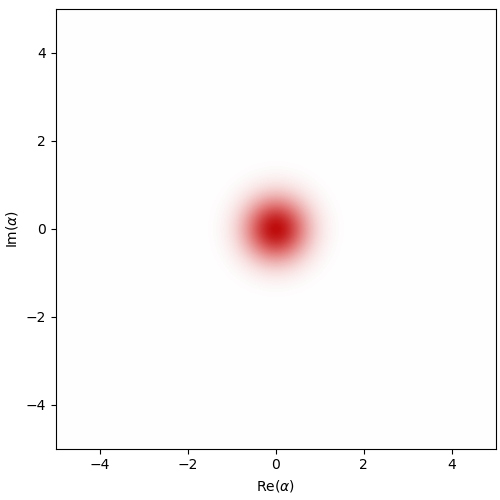

In [40]:
# Lab frame simulation
res_lab = dq.mesolve(H_lab, c_ops, psi0, tsave)
dq.plot.wigner_gif(res_lab.states, fps=24)  # plot Wigner function for mode a


|██████████| 100.0% ◆ elapsed 06m14s ◆ remaining 0.00ms  
100%|██████████| 120/120 [07:12<00:00,  3.61s/it]


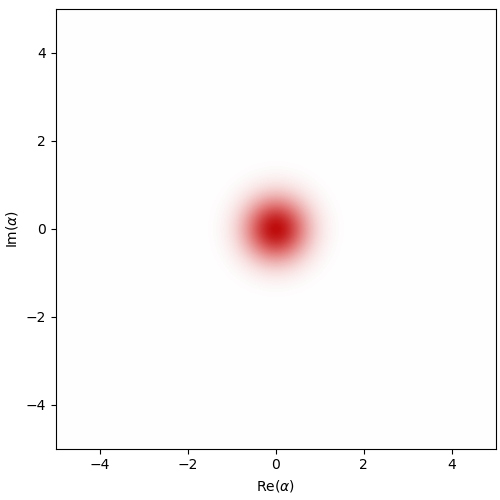

In [21]:
# Rotated–displaced frame simulation
res_rd = dq.mesolve(H_rd, c_ops, psi0, tsave)
dq.plot.wigner_gif(res_rd.states, fps=24)  # plot Wigner function for mode a